<a href="https://colab.research.google.com/github/NoorFatimaMemon/DeepLearning/blob/main/27_GAN_Image_Generation/27_DCGAN_In_Pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **DCGAN Tutorial**

## **Generative Adversarial Network (GAN)**
A GAN has two parts:
* **Generator (G):** creates fake images from random noise.
* **Discriminator (D):** decides if an image is real (from the dataset) or fake (from G).

Training continues until **D** can’t tell the difference (ideally 50% guess rate).

How it works in symbols:
* 𝑥 = real image, 𝑧 = random noise.
* 𝐷(𝑥) = probability that image 𝑥 is real.
* 𝐺(𝑧) = fake image from noise.
* 𝐷(𝐺(𝑧)) = probability that the fake looks real.

The goal:
* **D**: maximize log𝐷(𝑥) + log(1−𝐷(𝐺(𝑧)))
* **G**: maximize log𝐷(𝐺(𝑧))    (make D think fakes are real).

## **Deep Convolutional Generative Adversarial Network (GAN)**

A DCGAN is just a GAN that uses convolution layers in D and transpose convolution layers in G.
* Convolutions help D see image patterns.
* Transpose convolutions help G build images from noise.

In [2]:
# Import necessary libraries
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [3]:
# Set Random Seed for Reproducibility
manualSeed = 999
print("Random Seed:", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)   # sets PyTorch’s random generator

Random Seed: 999


In [4]:
# Hyperparameters
dataroot = "./data"
workers = 2              # Number of data loading workers
batch_size = 128
image_size = 64          # Target image size for training
nc = 3                   # Number of channels in the training images (3 for RGB)
nz = 100                 # Size of z latent vector (input to generator)
ngf = 64                 # Feature maps in generator
ndf = 64                 # Feature maps in discriminator
num_epochs = 30
lr = 0.0002
beta1 = 0.5              # Beta1 for Adam
ngpu = 1                 # Number of GPUs to use (0 for CPU)

In [5]:
# Data Loading & Preprocessing
transform = transforms.Compose([transforms.Resize(image_size),  # Resize from 32x32 to 64x64
                                transforms.CenterCrop(image_size), transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),])

dataset = datasets.CIFAR10(root=dataroot, download=True, transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

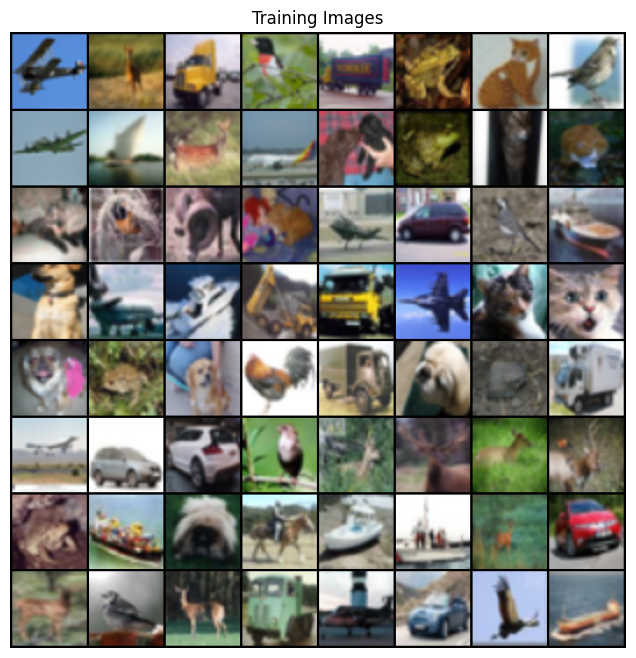

In [6]:
# Visualize some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=2, normalize=True), (1, 2, 0)))
plt.show()

In [7]:
# Weight Initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
# Generator
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False), nn.BatchNorm2d(ngf * 8), nn.ReLU(True),
                                  nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),nn.BatchNorm2d(ngf * 4), nn.ReLU(True),
                                  nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf * 2), nn.ReLU(True),
                                  nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf), nn.ReLU(True),
                                  nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),nn.Tanh())

    def forward(self, input):
        return self.main(input)


netG = Generator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [9]:
# Discriminator
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(nn.Conv2d(nc, ndf, 4, 2, 1, bias=False), nn.LeakyReLU(0.2, inplace=True),
                                  nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf * 2), nn.LeakyReLU(0.2, inplace=True),
                                  nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf * 4), nn.LeakyReLU(0.2, inplace=True),
                                  nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf * 8), nn.LeakyReLU(0.2, inplace=True),
                                  nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False), nn.Sigmoid())

    def forward(self, input):
        return self.main(input)

netD = Discriminator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [10]:
# 7. Loss & Optimizers
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
# Training Loop
img_list, G_losses, D_losses, iters = [], [], [], 0
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        # Update Discriminator
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        # Update Generator
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print(f"[{epoch}/{num_epochs}][{i}/{len(dataloader)}] "
                  f"Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} "
                  f"D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}")

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

Starting Training Loop...
[0/30][0/391] Loss_D: 1.6348 Loss_G: 6.2323 D(x): 0.5443 D(G(z)): 0.5501 / 0.0032
[0/30][50/391] Loss_D: 0.0295 Loss_G: 24.4227 D(x): 0.9730 D(G(z)): 0.0000 / 0.0000
[0/30][100/391] Loss_D: 0.1007 Loss_G: 7.2741 D(x): 0.9504 D(G(z)): 0.0336 / 0.0009
[0/30][150/391] Loss_D: 0.8994 Loss_G: 3.2339 D(x): 0.5121 D(G(z)): 0.0146 / 0.0690
[0/30][200/391] Loss_D: 0.9785 Loss_G: 4.7302 D(x): 0.4828 D(G(z)): 0.0049 / 0.0157
[0/30][250/391] Loss_D: 0.2365 Loss_G: 8.3338 D(x): 0.9763 D(G(z)): 0.1388 / 0.0006
[0/30][300/391] Loss_D: 0.1348 Loss_G: 6.3953 D(x): 0.9459 D(G(z)): 0.0532 / 0.0043
[0/30][350/391] Loss_D: 0.2938 Loss_G: 6.2964 D(x): 0.8001 D(G(z)): 0.0015 / 0.0033
[1/30][0/391] Loss_D: 0.5030 Loss_G: 10.9526 D(x): 0.9582 D(G(z)): 0.3431 / 0.0000
[1/30][50/391] Loss_D: 0.5195 Loss_G: 2.7810 D(x): 0.6977 D(G(z)): 0.0293 / 0.0872
[1/30][100/391] Loss_D: 0.2301 Loss_G: 3.6744 D(x): 0.8920 D(G(z)): 0.0955 / 0.0422
[1/30][150/391] Loss_D: 0.2936 Loss_G: 3.8491 D(x): 0.

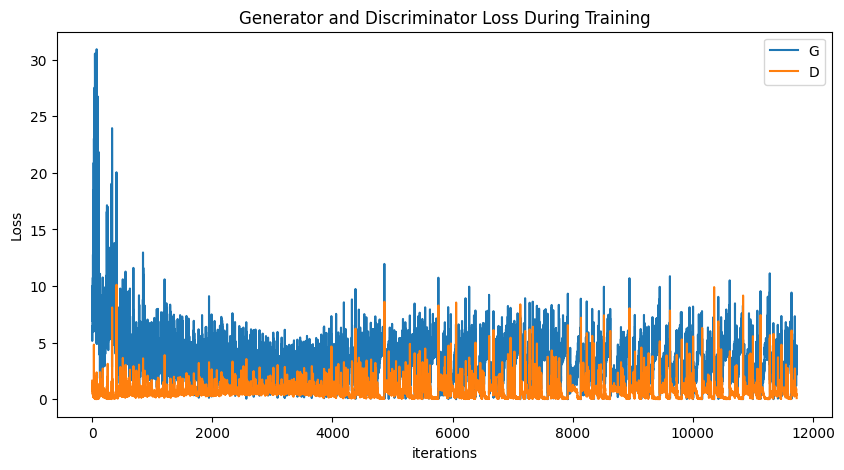

In [12]:
# Results Visualization
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

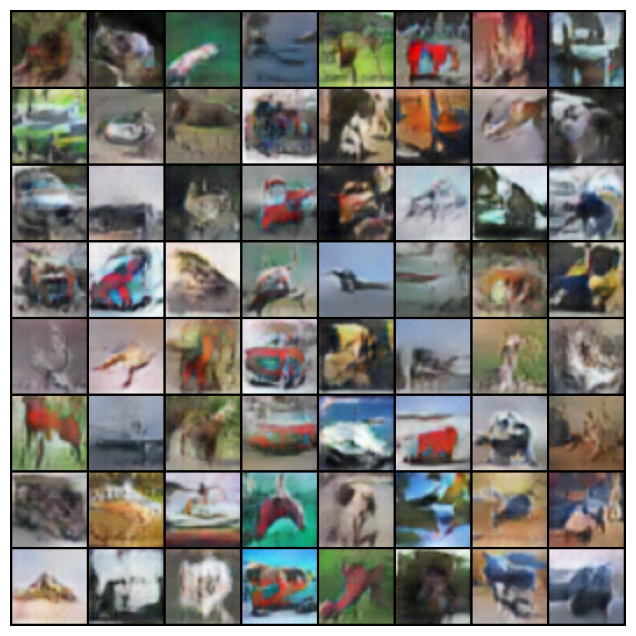

In [13]:
# Animation of Generator progression
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

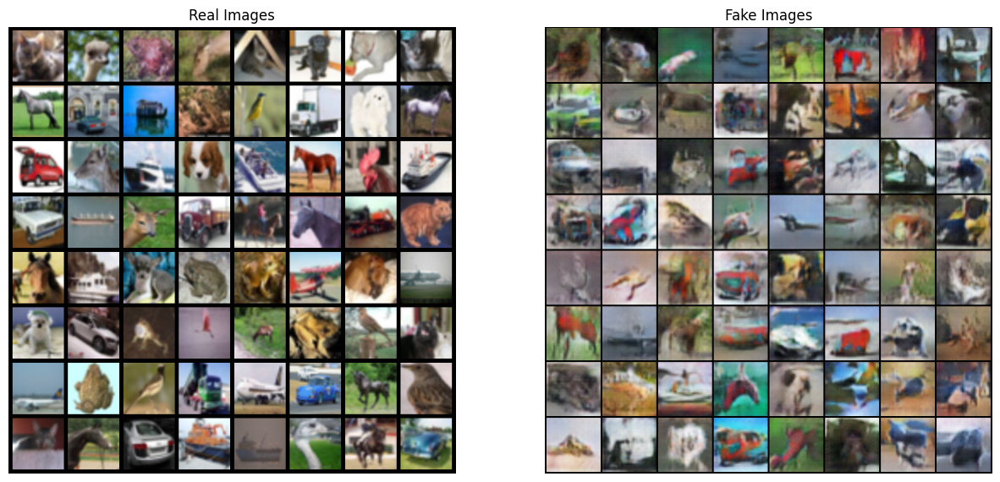

In [14]:
# Real vs Fake images
real_batch = next(iter(dataloader))
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=5, normalize=True),(1,2,0)))
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()